## Data Augmentation

In [1]:
from parameters import *
from tools.data_generator import DataGenerator
from tools.data_provider import DataProvider
from tools.data_preprocessor import DataPreprocessor
from tools.data_explorer import DataExplorer

DATA = DATA

provider = DataProvider(DATA, LOG_FILE, TRAIN_BATCH_SIZE)

X, y = provider.get_random_log_raw_pictures(DATA, LOG_FILE, TRAIN_BATCH_SIZE)

explorer = DataExplorer()
generator = DataGenerator()

image = X[0]
steering_angle = float(y[0])

# Left and right camera images
images_with_titles = []
images_with_titles.append((X[1], "Left Camera - Steering Angle Adjusted = %0.2f" % float(y[1])))
images_with_titles.append((X[0], "Center Camera - Original Steering Angle = %0.2f" % float(y[0])))
images_with_titles.append((X[2], "Right Camera - Steering Angle Adjusted = %0.2f" % float(y[2])))
explorer.plot_3(images_with_titles)

# Random brightness
image_generated1 = generator.random_brightness(image)
image_generated2 = generator.random_brightness(image)

images_with_titles = []
images_with_titles.append((image, "Original"))
images_with_titles.append((image_generated1, "Random Brightness - Example 1"))
images_with_titles.append((image_generated2, "Random Brightness - Example 2"))
explorer.plot_3(images_with_titles)

# Random flip
gen_img1, gen_sa1 = generator.random_flip(image, steering_angle)
gen_img2, gen_sa2 = generator.random_flip(image, steering_angle)

images_with_titles = []
images_with_titles.append((image, "Original"))
images_with_titles.append((gen_img1, "Random Flip - Steering Angle = %0.2f" % gen_sa1))
images_with_titles.append((gen_img2, "Random Flip - Steering Angle = %0.2f" % gen_sa2))
explorer.plot_3(images_with_titles)

# Random transformation
gen_img1, gen_sa1 = generator.random_transformation(image, steering_angle)
gen_img2, gen_sa2 = generator.random_transformation(image, steering_angle)

images_with_titles = []
images_with_titles.append((image, "Original - Steering Angle = %0.2f" % steering_angle))
images_with_titles.append((gen_img1, "Random Transform - Steering Angle Adjusted = %0.2f" % gen_sa1))
images_with_titles.append((gen_img2, "Random Transform - Steering Angle Adjusted = %0.2f" % gen_sa2))
explorer.plot_3(images_with_titles)

# Random stripe 
gen_img1 = generator.random_stripes(image)
gen_img2 = generator.random_stripes(image)

images_with_titles = []
images_with_titles.append((image, "Original"))
images_with_titles.append((gen_img1, "Random Stripe - Example 1"))
images_with_titles.append((gen_img2, "Random Stripe - Example 2"))
explorer.plot_3(images_with_titles)


Using TensorFlow backend.



RAW log:
 - center: 41819
 - left: 41819
 - right: 41819
 - discarded: 14783

Log:
 - total images : 124680

Data:
 - train: 118446
 - test: 6234

RAW log:
 - center: 41804
 - left: 41804
 - right: 41804
 - discarded: 14798

Log:
 - total images : 3
Generating data.
hi


## Training Data Batch



RAW log:
 - center: 571
 - left: 571
 - right: 571
 - discarded: 2562

Log:
 - total images : 1701

Data:
 - train: 1445
 - test: 256


Getting train batch 0/1. Generating data.
.....................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

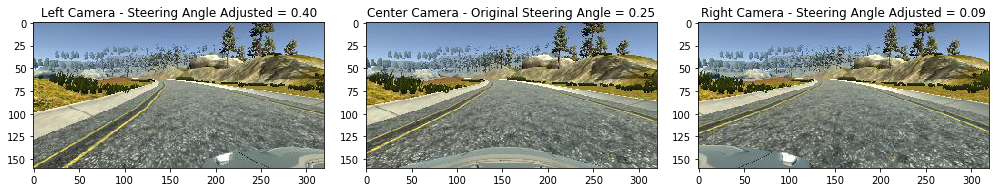

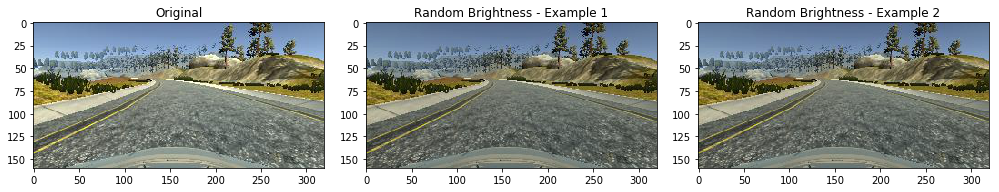

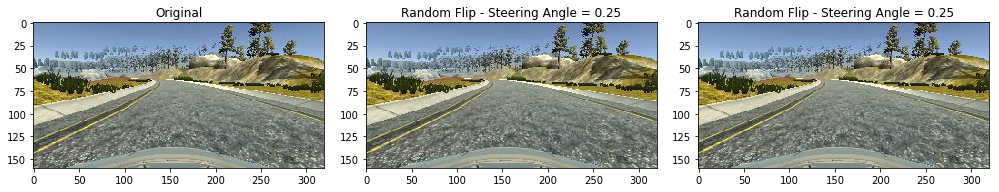

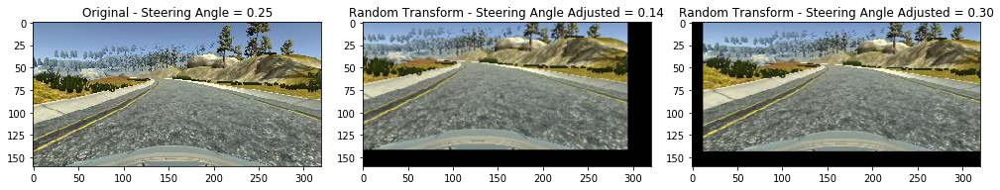

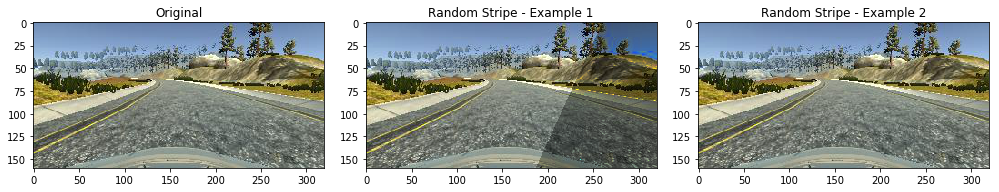

...

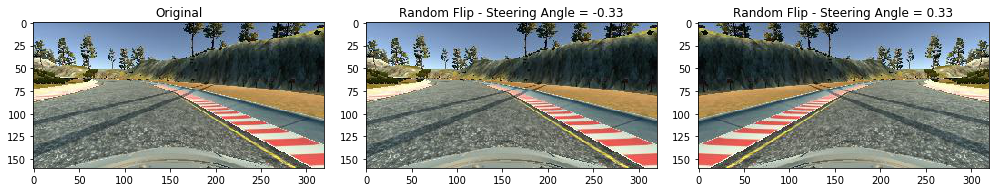

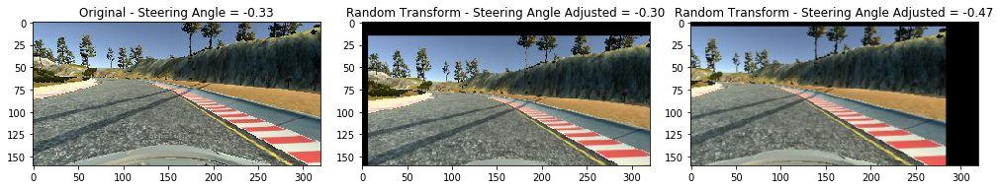

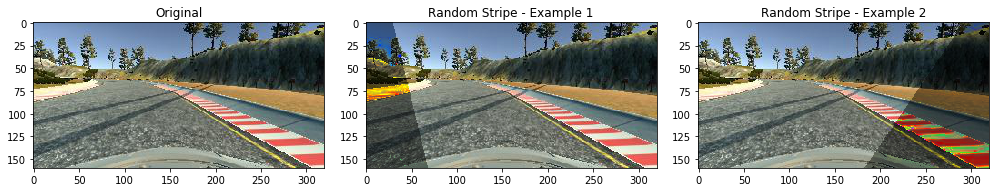

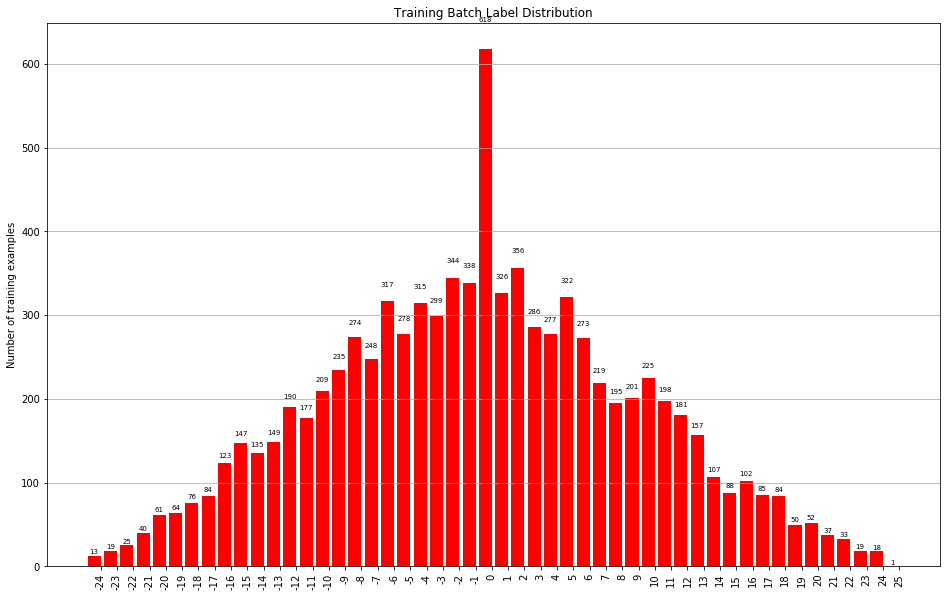

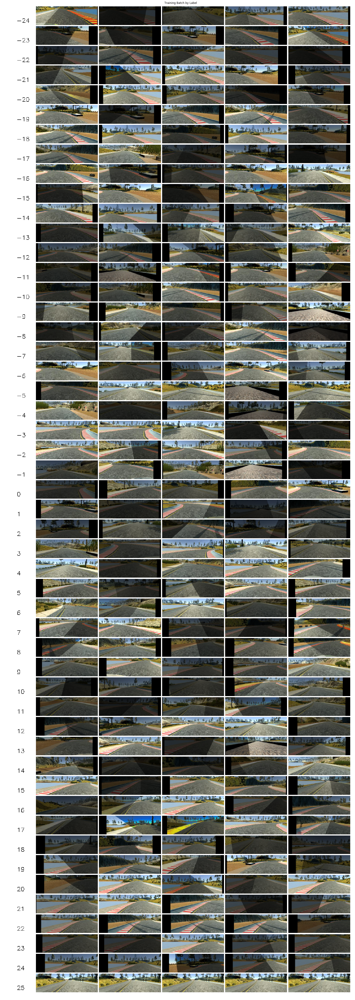

/Users/miha/anaconda/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


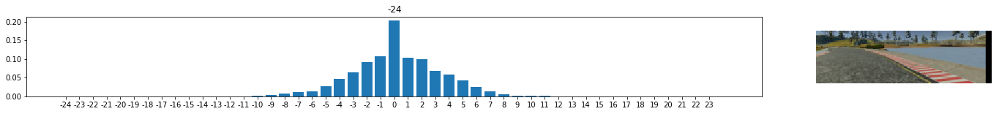

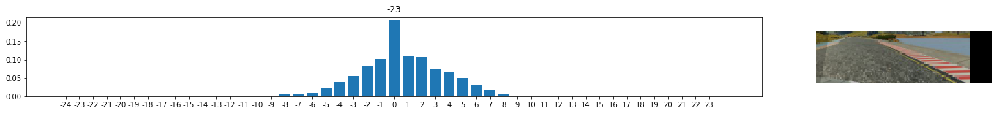

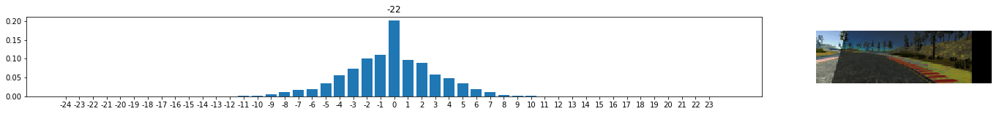

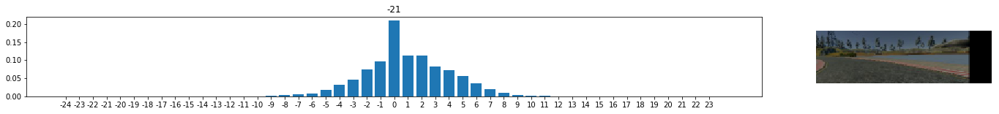

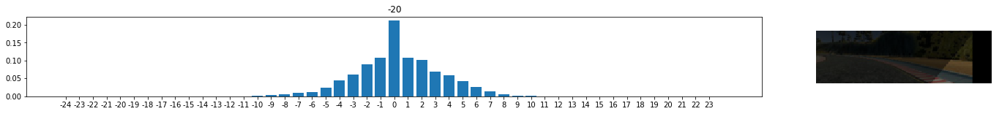

...

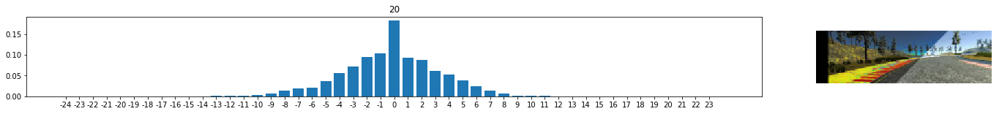

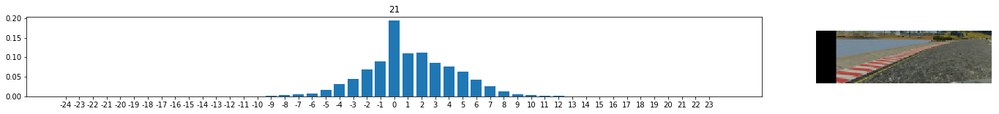

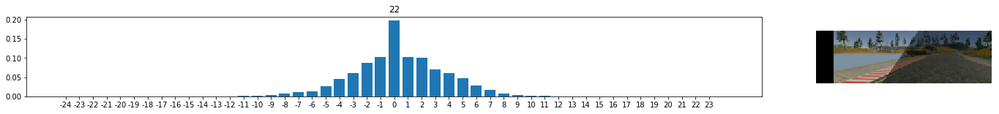

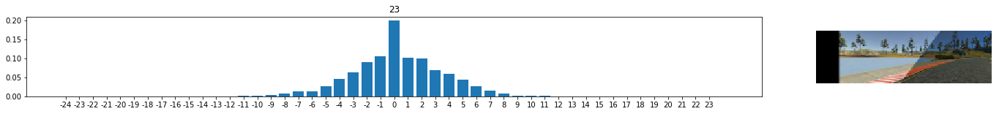

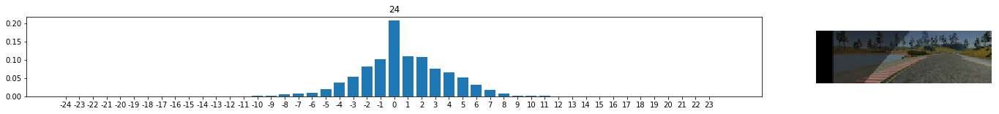

In [4]:
show_samples = True

from parameters import *
from tools.data_provider import DataProvider
from tools.data_preprocessor import DataPreprocessor
from tools.data_explorer import DataExplorer

DATA = DATA
provider = DataProvider(DATA, LOG_FILE, TRAIN_BATCH_SIZE)

for X_train_raw, y_train_raw, count in provider.get_next_batch_of_raw_train_data():
    X = X_train_raw
    y = y_train_raw
    break

preprocessor = DataPreprocessor()
X_train, y_train = preprocessor.preprocess(X_train_raw, y_train_raw)

explorer = DataExplorer()
images_by_labels = explorer.sort_images_by_labels(X_train, y_train)

explorer.draw_data_distribution_by_class(images_by_labels, "Training Batch Label Distribution")

if show_samples:
    explorer.draw_random_image_examples_by_class(images_by_labels, "Training Batch by Label")
    
explorer.show_softmax_probabilities_by_class(images_by_labels, 'Softmax Probabilities for Random Candidate by Label', './models/model0010-3.1702-0.0934.h5')


## Train Data - Lane Driving



RAW log:
 - center: 1819
 - left: 1819
 - right: 1819
 - discarded: 2096

Log:
 - total images : 5436

Data:
 - train: 4620
 - test: 816


Getting test data...


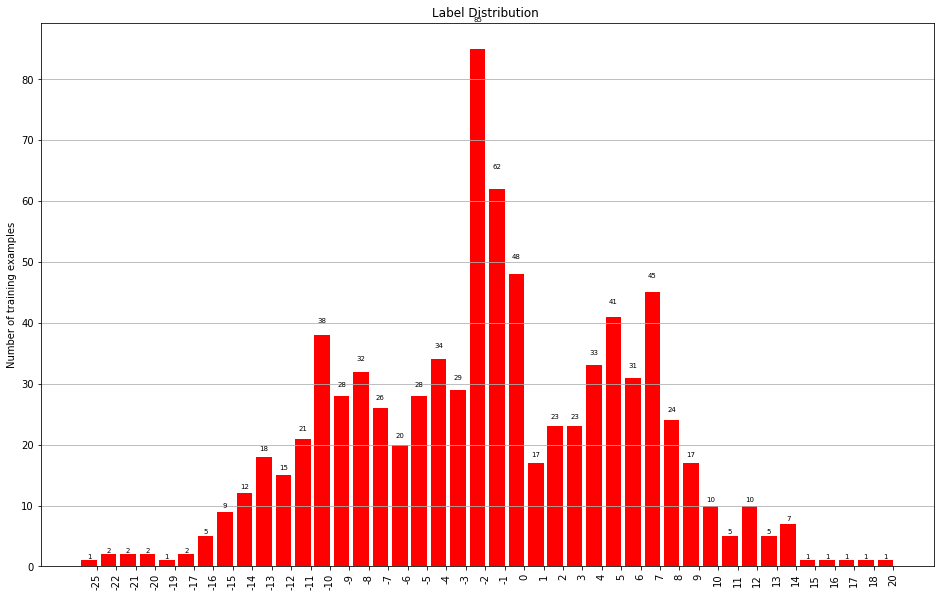

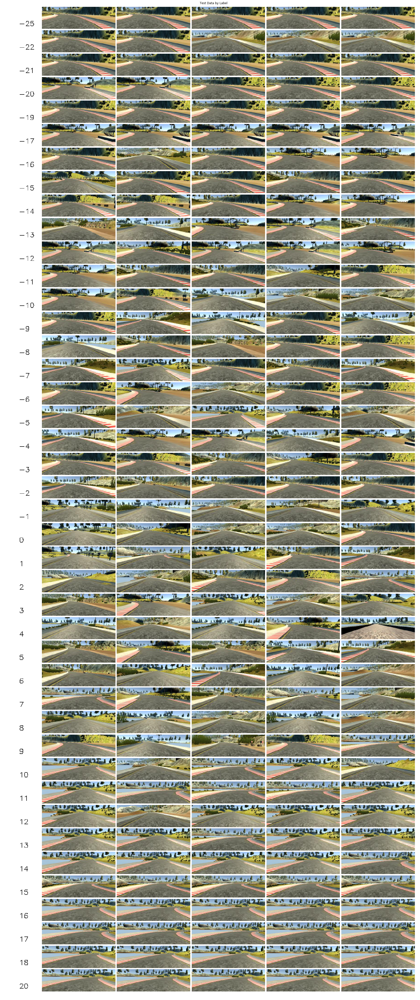

/Users/miha/anaconda/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


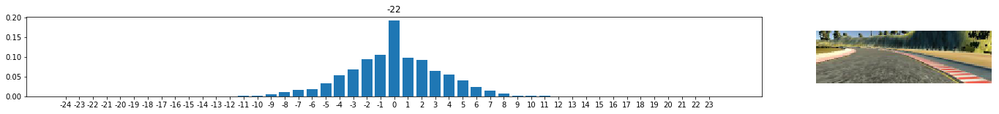

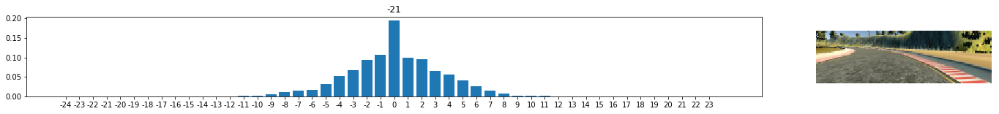

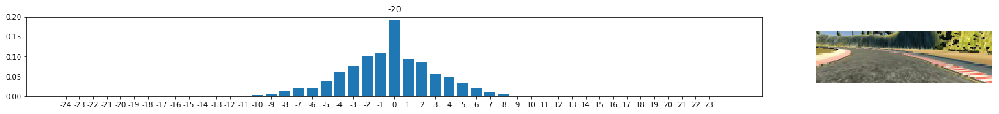

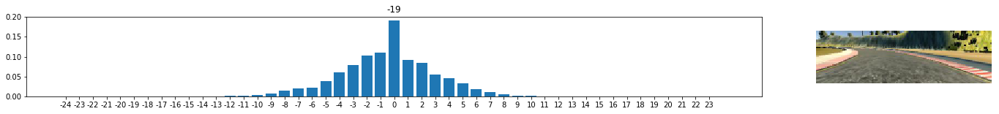

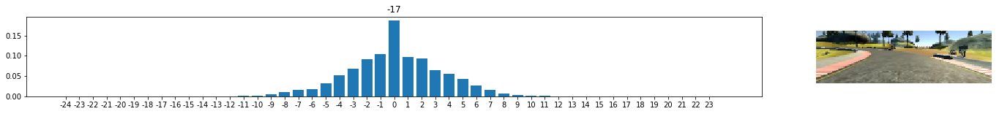

...

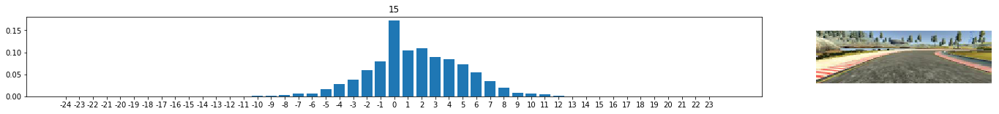

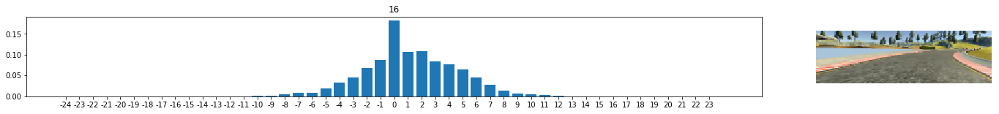

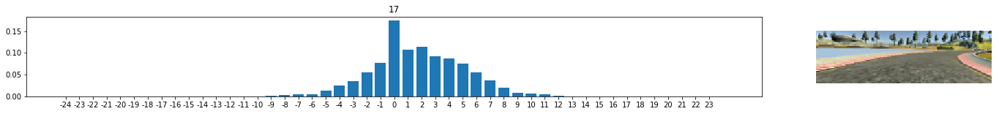

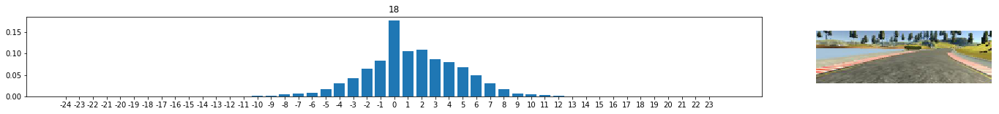

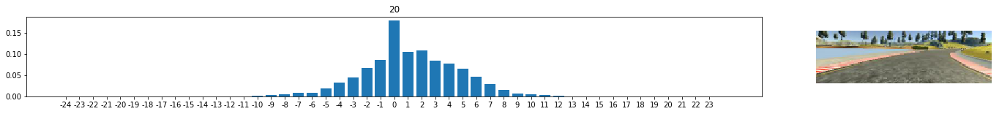

In [4]:
show_samples = True

from parameters import *
from tools.data_provider import DataProvider
from tools.data_preprocessor import DataPreprocessor
from tools.data_explorer import DataExplorer

DATA = [DATA01]
provider = DataProvider(DATA, LOG_FILE, TRAIN_BATCH_SIZE)

X_test_raw, y_test_raw = provider.get_raw_test_data()

preprocessor = DataPreprocessor()
X_test, y_test = preprocessor.preprocess(X_test_raw, y_test_raw)

explorer = DataExplorer()
images_by_labels = explorer.sort_images_by_labels(X_test, y_test)

explorer.draw_data_distribution_by_class(images_by_labels, "Label Distribution ")

if show_samples:
    explorer.draw_random_image_examples_by_class(images_by_labels, "Test Data by Label")

explorer.show_softmax_probabilities_by_class(images_by_labels, 'Softmax Probabilities for Random Candidate by Label',
                                             './models/model0010-3.1702-0.0934.h5')

## Train Data



RAW log:
 - center: 2155
 - left: 2155
 - right: 2155
 - discarded: 2757

Log:
 - total images : 6381

Data:
 - train: 5423
 - test: 958


Getting test data...


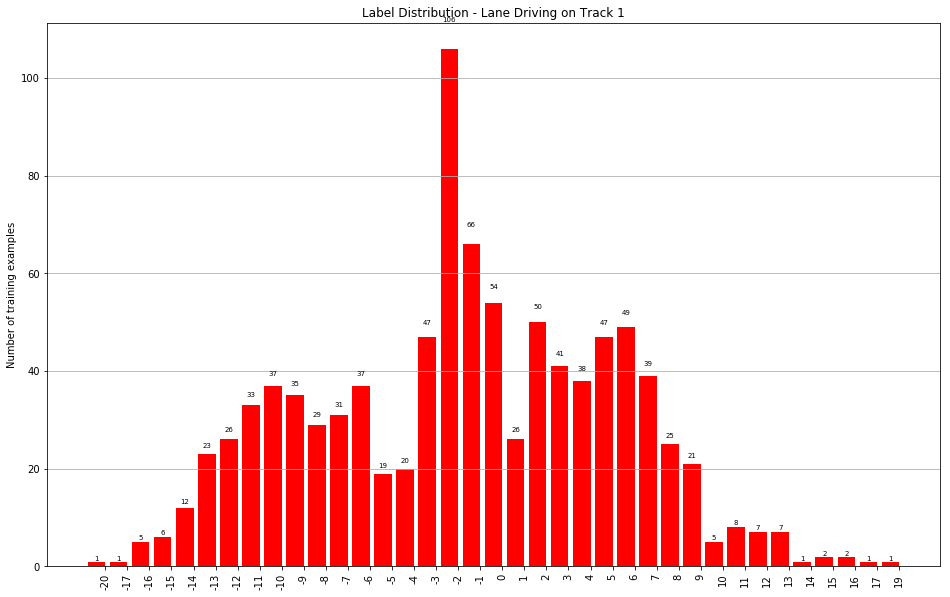

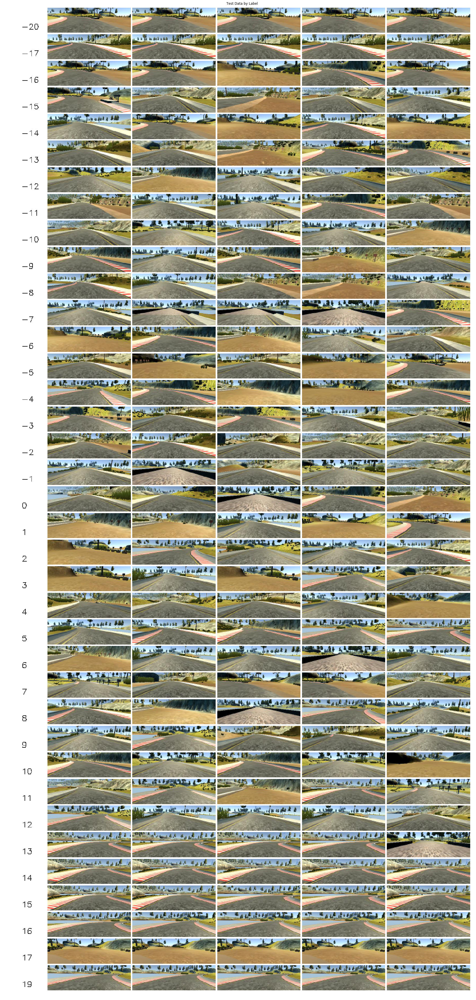

/Users/miha/anaconda/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


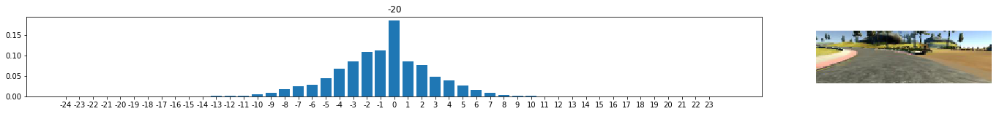

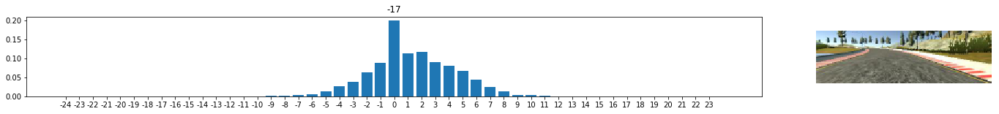

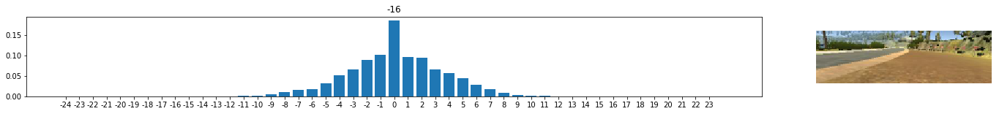

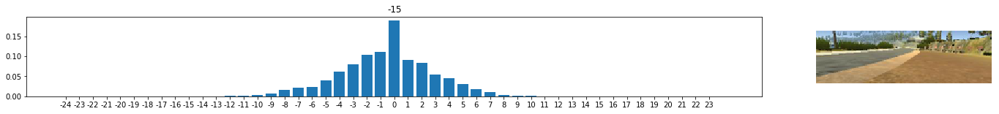

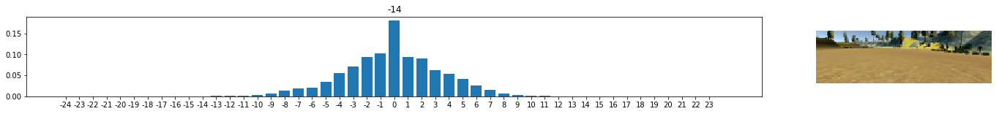

...

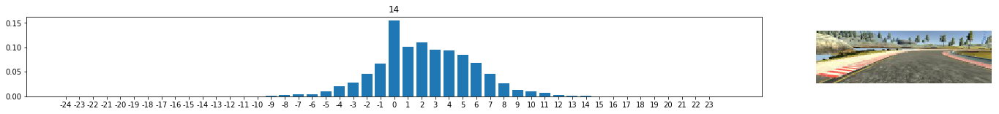

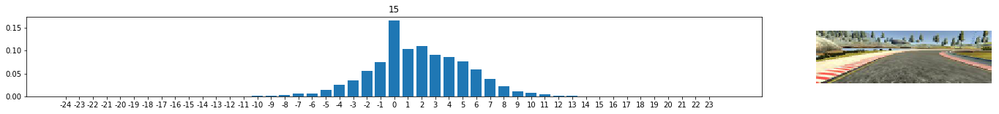

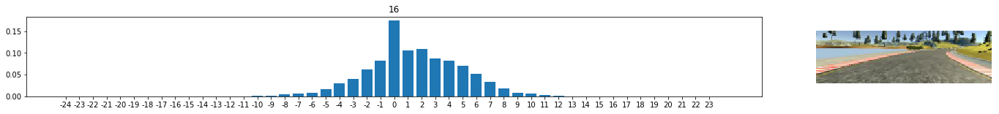

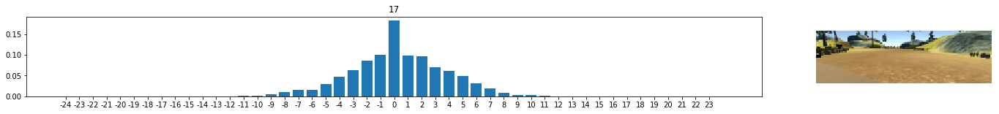

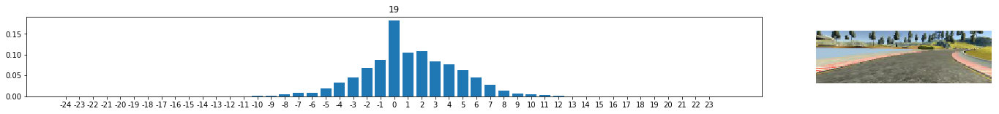

In [6]:
show_samples = True

from parameters import *
from tools.data_provider import DataProvider
from tools.data_preprocessor import DataPreprocessor
from tools.data_explorer import DataExplorer

DATA = [DATA02]
provider = DataProvider(DATA, LOG_FILE, TRAIN_BATCH_SIZE)

X_test_raw, y_test_raw = provider.get_raw_test_data()

preprocessor = DataPreprocessor()
X_test, y_test = preprocessor.preprocess(X_test_raw, y_test_raw)

explorer = DataExplorer()
images_by_labels = explorer.sort_images_by_labels(X_test, y_test)

explorer.draw_data_distribution_by_class(images_by_labels, "Label Distribution - Lane Driving on Track 1")

if show_samples:
    explorer.draw_random_image_examples_by_class(images_by_labels, "Test Data by Label")

explorer.show_softmax_probabilities_by_class(images_by_labels, 'Softmax Probabilities for Random Candidate by Label',
                                             './models/model0010-3.1702-0.0934.h5')


RAW log:
 - center: 2234
 - left: 2234
 - right: 2234
 - discarded: 2358

Log:
 - total images : 6702

Data:
 - train: 5696
 - test: 1006


Getting test data...


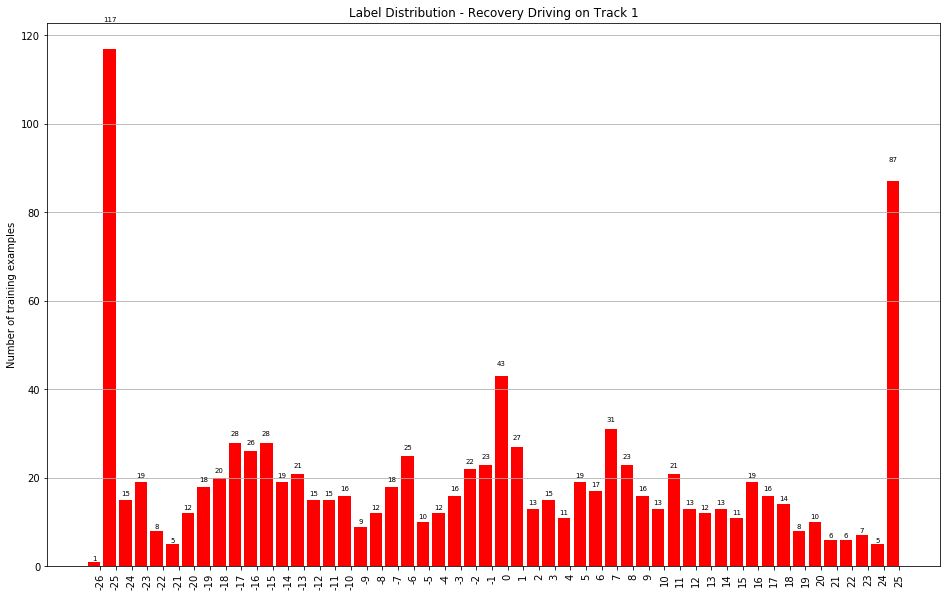

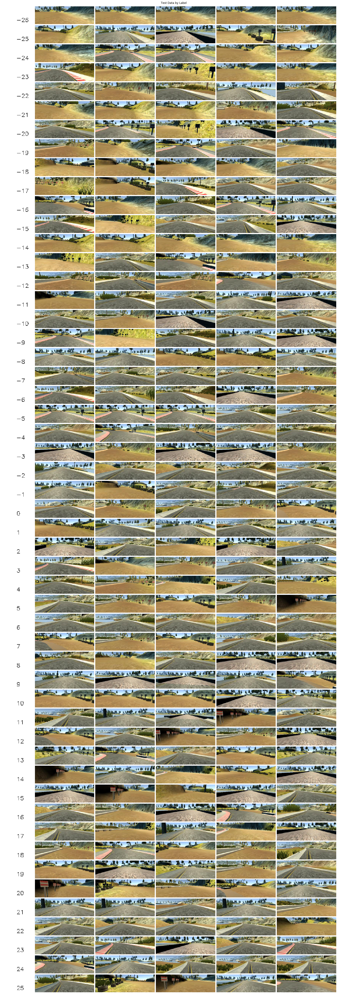

/Users/miha/anaconda/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


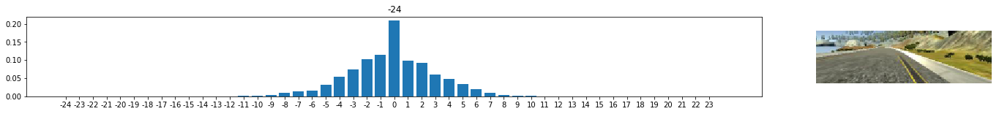

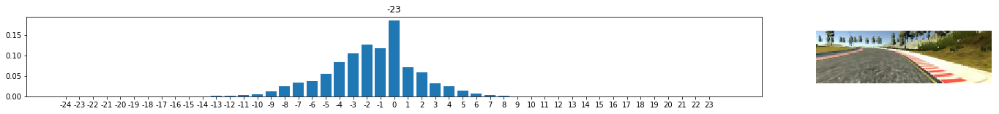

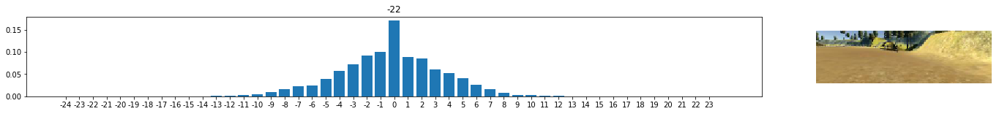

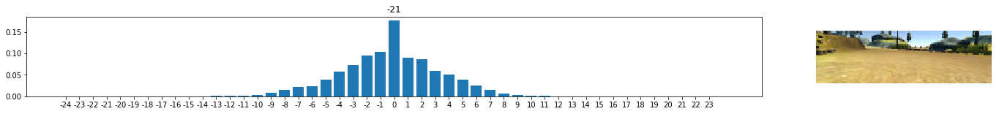

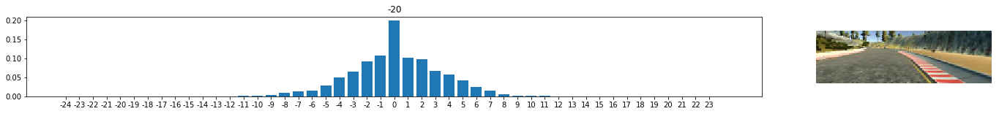

...

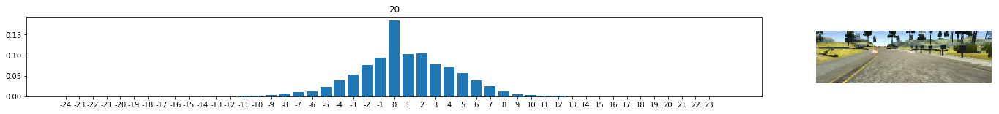

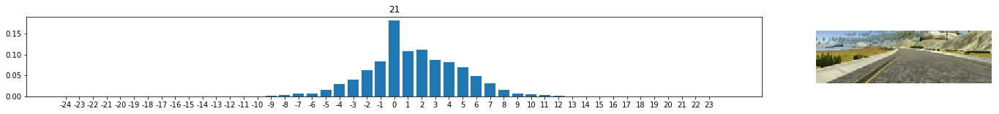

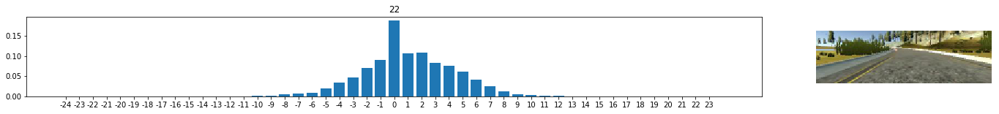

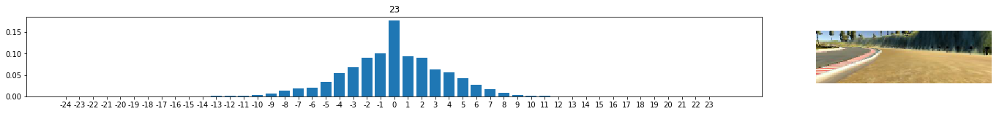

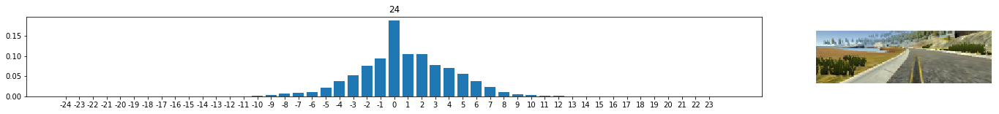

In [7]:
show_samples = True

from parameters import *
from tools.data_provider import DataProvider
from tools.data_preprocessor import DataPreprocessor
from tools.data_explorer import DataExplorer

DATA = [DATA05]
provider = DataProvider(DATA, LOG_FILE, TRAIN_BATCH_SIZE)

X_test_raw, y_test_raw = provider.get_raw_test_data()

preprocessor = DataPreprocessor()
X_test, y_test = preprocessor.preprocess(X_test_raw, y_test_raw)

explorer = DataExplorer()
images_by_labels = explorer.sort_images_by_labels(X_test, y_test)

explorer.draw_data_distribution_by_class(images_by_labels, "Label Distribution - Recovery Driving on Track 1")

if show_samples:
    explorer.draw_random_image_examples_by_class(images_by_labels, "Test Data by Label")

explorer.show_softmax_probabilities_by_class(images_by_labels, 'Softmax Probabilities for Random Candidate by Label',
                                             './models/model0010-3.1702-0.0934.h5')